## Monte Carlo simulering af atomers vekselvirkning
Denne aflevering arbejdes der med vekselvirkning mellem atomer. Denne vekselvirkning er baseret på et grund princip inden for kvantemekanik hvor, i dette tilfælde, en klynge af atomer opsøger det lavest mulige energistadie. I denne opgave prøver vi derfor at simulerer processen hvorfra atomer går fra at være i et højere energistadie til et lavere, altså at vores klynge bliver optimeret ned hensyn til den potentielle energi.

### Delopgave a)
Vi indleder med at opskrive en klasse som vi senere benytter til at simulerer klyngens bevægelse. 

Klassen skal indeholde følgende elementer: 

$\textbf{Attributter:}$

.r - en Numpy array ned atomets position

.artist - Et Line2D objekt som definere objektets farve og form 

$\textbf{Metoder:}$

.plot(ax) - som plotter vores Line2D objekt

.get_potential_energy(other_atoms) - som beregner summen af alle vekselvirkner i klyngen baseret på Lennard-Jones potentialet angivet ved formlen:

$V(r)=4\epsilon[(\frac{\sigma}{r})^{12}-(\frac{\sigma}{r})^{6}]$

hvor $\epsilon=1 eV$ og $\sigma=1 Å$. 

.monte_carlo_step(other_atoms) - som flytter et atom med en normalt-fordelt distance med aplituden 0.1 i en vilkårlig retning såfremt Metropolis Monte-Carlo-betingelsen er opfyldt.Metropolis Monte-Carlo-betingelsen er angivet ved formlen: 

$n<exp(-\Delta U/\Delta U_0)$

Således kan vi nu opskrive klassen.

In [2]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt 
from matplotlib import animation
plt.rc('animation', html='jshtml')
#Navnet på klassen angives som Atom 
class Atom():
    #Kald den indbyggede metode __init__ som igangsætter dataen. Det er her værdierne for vores attributter er angivet
    def __init__(self,r=[0,0]):
        self.r=np.array(r)
        self.artist=None
    #Definer metoden plot som tegner vores Line2D objekt
    def plot(self,ax):
        if self.artist is None:
            self.artist, =ax.plot(self.r[0],self.r[1],'ro',markeredgecolor='k',ms=42)
        else: 
            self.artist.set_data(self.r[0],self.r[1]) 
    #Definer metoden get_potential_energy som beregner summen af den potentielle energi ved at ligge værdien for hver vekselvirkning til U=0. 
    def get_potential_energy(self,other_atoms):  
        U=0 
        for i in range(len(other_atoms)):
            other_atom=other_atoms[i]
            if other_atom == self: 
                continue 
            dis=np.linalg.norm(other_atom.r-self.r) #
            U+=4*((1/dis)**12-(1/dis)**6)
        return U
    
    #Definer metoden monte_carlo_step bestemmer om et atom bevæger sig ud fra Monte-Carlo-betingelsen
    def monte_carlo_step(self,other_atoms):
        U_f=self.get_potential_energy(other_atoms) #Den potentielle energi før bevægelsen beregnes
        n=np.random.random() #n er et tilfældigt tal mellem 0 og 1
        theta=2*np.pi*np.random.random() #vinklen i en tilfældig retning genereres
        delta_r=np.random.rand()*0.1*np.array([np.cos(theta),np.sin(theta)]) #bevægelsen i en tilfældig retning genereres                            
        self.r += delta_r #bevægelsen ligges til den positionen
        U_e=self.get_potential_energy(other_atoms) #Den potentielle energi efter bevægelsen beregnes
        dU= U_e - U_f #Ændringen i potentiel energi udregnes
        #En if-statement som indeholder Monte-Carlo-betingelsen kaldes
        if n < np.exp(-(dU/(0.1))) or dU < 0:
            return
        else: 
            self.r += -delta_r
        



### Delopgave b)

Vi laver nu en klynge af 4 atomer og demonstrerer at den potentielle energi for systemet falder når vi kalder .monte_carlo_step(other_atoms). 

Startpositionerne for atomerne i klyngen er:

$r_1=(1,1)$,  $r_2=(-1,-1)$,  $r_3=(-1,1)$,  $r_4=(1,-1)$

Atomerne før og efter .monte_carlo_step(other_atoms) bliver kaldt er plottet nedenfor


Den potentielle energi før er -0.1308441162109375


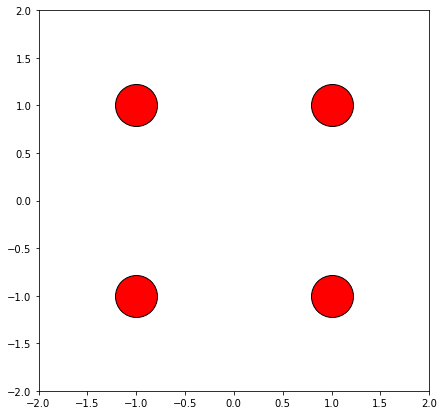

In [3]:
fig,ax = plt.subplots(figsize=[7,7])
atom1 = Atom([1.,1.])
atom2 = Atom([-1.,-1.])
atom3 = Atom([-1.,1.])
atom4 = Atom([1.,-1.])

other_atoms1 = [atom2,atom3,atom4]
other_atoms2 = [atom1,atom3,atom4]
other_atoms3 = [atom1,atom2,atom4]
other_atoms4 = [atom1,atom2,atom3]

ax.set_xlim(-2,2)
ax.set_ylim(-2,2)

print("Den potentielle energi før er", atom1.get_potential_energy(other_atoms1))

atom1.plot(ax)
atom2.plot(ax)
atom3.plot(ax)
atom4.plot(ax)

Den potentielle energi efter er -2.003305936156383


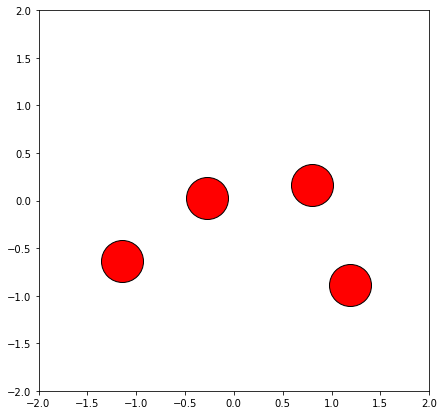

In [4]:
fig,ax = plt.subplots(figsize=[7,7])
ax.set_xlim(-2,2)
ax.set_ylim(-2,2)

atom1 = Atom([1.,1.])
atom2 = Atom([-1.,-1.])
atom3 = Atom([-1.,1.])
atom4 = Atom([1.,-1.])

other_atoms1 = [atom2,atom3,atom4]
other_atoms2 = [atom1,atom3,atom4]
other_atoms3 = [atom1,atom2,atom4]
other_atoms4 = [atom1,atom2,atom3]

for i in range(100):
    atom1.monte_carlo_step(other_atoms1)
    atom2.monte_carlo_step(other_atoms2)
    atom3.monte_carlo_step(other_atoms3)
    atom4.monte_carlo_step(other_atoms4)

atom1.plot(ax)
atom2.plot(ax)
atom3.plot(ax)
atom4.plot(ax)

print("Den potentielle energi efter er", atom1.get_potential_energy(other_atoms1))

Vi ser altså at afstanden mellem atomerne formindskes og den potentielle energi for klyngen bliver mindre

### Delopgave c
Vi inkluderer nu alle 12 atomer og plotter dem før og efter optimeringen. 

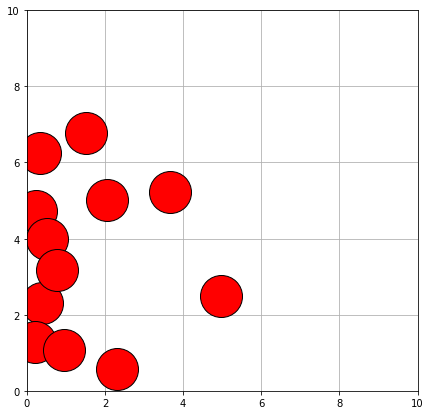

In [5]:
fig, ax = plt.subplots(figsize=(7,7))
ax.set_xlim([0,10])
ax.set_ylim([0,10])
ax.grid()

atoms=[]
other_atoms = atoms
no_of_atoms = 12 

def pos(x):
    pos = np.random.rand((2))*x
    return pos

for i in range(no_of_atoms):
    atom = Atom()
    atom.r = pos(7)
    atoms.append(atom)
    atom.plot(ax)

<ipython-input-2-26b1016f8eb1>:39: RuntimeWarning: overflow encountered in exp
  if n < np.exp(-(dU/(0.1))) or dU < 0:


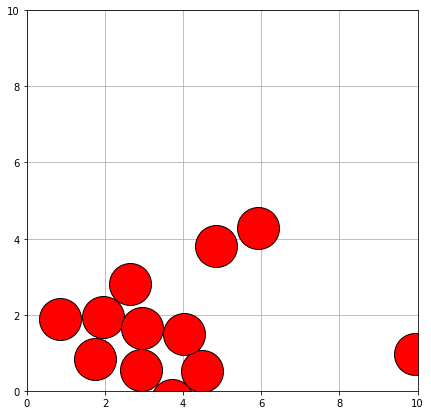

In [6]:
ax.set_xlim(0,10)
ax.set_ylim(0,10)

atoms=[]
other_atoms = atoms
no_of_atoms = 12 

def pos(x):
    pos = np.random.rand((2))*x
    return pos

for i in range(no_of_atoms):
    atom = Atom()
    atom.r = pos(7)
    atoms.append(atom)
    
fig, ax = plt.subplots(figsize=(7,7))
ax.set_xlim([0,10])
ax.set_ylim([0,10])
ax.grid()
    
for atom in atoms:
    for i in range(3000):
        atom.monte_carlo_step(atoms)
        atom.plot(ax)


### Delopgave d
Vi laver nu en katalog med de optimale strukturer af klynger fra 4 til 13 atomer 

<ipython-input-2-26b1016f8eb1>:39: RuntimeWarning: overflow encountered in exp
  if n < np.exp(-(dU/(0.1))) or dU < 0:


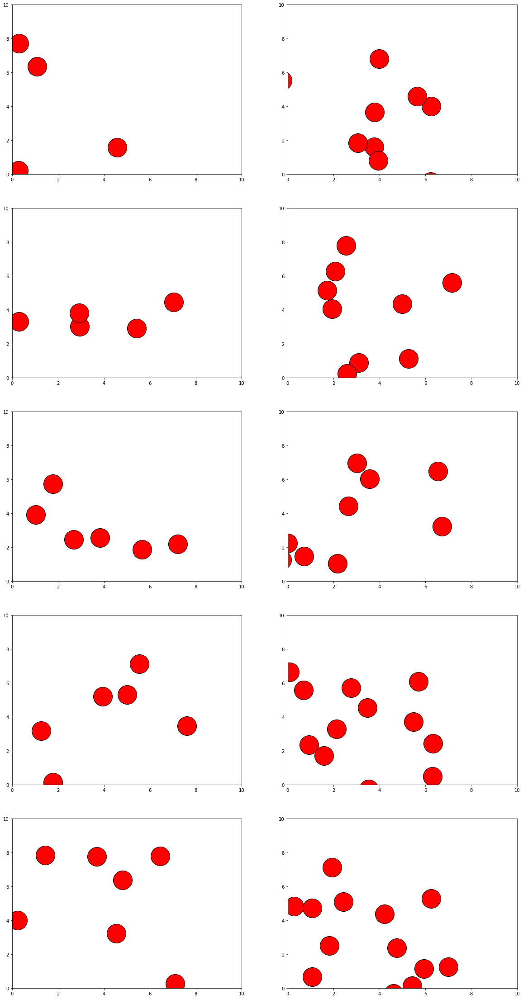

In [7]:
fig, axs = plt.subplots(5,2, figsize=(20,40))
for i in [0,1,2,3,4]:
    axs[i,0].set_xlim([0,10])
    axs[i,0].set_ylim([0,10])
for i in [0,1,2,3,4]:
    axs[i,1].set_xlim([0,10])
    axs[i,1].set_ylim([0,10])

def pos(x):
    pos = np.random.rand((2))*x
    return pos

atoms=[]
other_atoms = atoms

for i in [4,5,6,7,8,9,10,11,12,13]:
    no_of_atoms=i
    if i<9:
        ax=axs[i-4,0]
    if 8<i<14:
        ax=axs[i-9,1]
        
    for j in range(no_of_atoms):
        atom = Atom()
        atom.r = pos(7)
        atoms.append(atom)
        
    for atom in atoms:
        for i in range(100):   
             atom.monte_carlo_step(atoms)
        atom.plot(ax)

Det var desværre ikke muligt at opnå den mest optimale struktur. Dette skyldes bl.a. at det tager meget lang tid at køre atom.monte_carlo_step(atoms) flere end 100 gange.


Animation size has reached 20989976 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


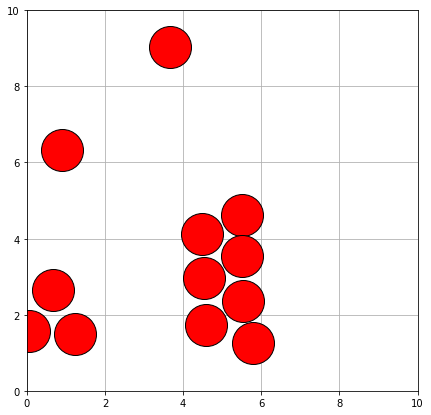

In [8]:
atoms=[]
other_atoms = atoms
no_of_atoms = 12 

#Her defineres en funktion som generere et tilfældigt (x,y) koordinat
def pos(x):
    pos = np.random.rand((2))*x
    return pos

#Her defineres en funktion som giver hvert atom en tilfældig startposition
for i in range(no_of_atoms):
    atom = Atom()
    atom.r = pos(7)
    atoms.append(atom)
    
fig, ax = plt.subplots(figsize=(7,7))
ax.set_xlim([0,10])
ax.set_ylim([0,10])
ax.grid()

#update funktion til animationen
def update(i):
    for atom in atoms:
        atom.monte_carlo_step(atoms)
        atom.plot(ax)
    return [atom.artist]


anim = animation.FuncAnimation(fig,
                              update,
                              frames=1000,
                              interval=100,
                              blit=True,
                              repeat_delay=0)
anim